In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from ToyTrajectoryNet.utils import generate_steps, set_seeds, config_criterion
from ToyTrajectoryNet.models import make_model, Autoencoder
from ToyTrajectoryNet.plots import plot_comparision, plot_losses
from ToyTrajectoryNet.train import train, train_ae
from ToyTrajectoryNet.constants import ROOT_DIR, DATA_DIR, NTBK_DIR, IMGS_DIR, RES_DIR
from ToyTrajectoryNet.datasets import (
    make_diamonds, make_swiss_roll, make_tree, make_eb_data, 
    make_dyngen_data
)
from ToyTrajectoryNet.geo import setup_distance
from ToyTrajectoryNet.exp import setup_exp
from ToyTrajectoryNet.eval import generate_plot_data

import os, pandas as pd, numpy as np, \
    seaborn as sns, matplotlib as mpl, matplotlib.pyplot as plt, \
    torch, torch.nn as nn

from tqdm.notebook import tqdm
import time, pickle, scprep

os.environ['CUDA_LAUNCH_BLOCKING'] = '1'

# Load dataset

In [3]:
data_dir = os.path.join(DATA_DIR, '../../', 'mau-at2/data')

In [12]:
with open(os.path.join(data_dir, 'mau_mioflow_pca_loadings.pickle'), 'rb') as f:
    pca_loadings = pickle.load(f)
with open(os.path.join(data_dir, 'mau_mioflow_pca_components.pickle'), 'rb') as f:
    pca_components = pickle.load(f)
with open(os.path.join(data_dir, 'mau_mioflow_Y_phate.pickle'), 'rb') as f:
    Y_phate = pickle.load(f)
with open(os.path.join(data_dir, 'mau_mioflow_cell_ids.pickle'), 'rb') as f:
    cell_ids = pickle.load(f)
with open(os.path.join(data_dir, 'mau_mioflow_df_all_col.pickle'), 'rb') as f:
    df = pickle.load(f)
with open(os.path.join(data_dir, 'mau_mioflow_df_for_pca.pickle'), 'rb') as f:
    dfff = pickle.load(f)
with open(os.path.join(data_dir, 'mau_mioflow_time.pickle'), 'rb') as f:
    time_samples = pickle.load(f)

In [46]:
ptime = np.round(time_samples.values * 10)
ptime[ptime == 10.0] = 9.0

In [9]:
DF = dfff.reset_index().sort_values(['cell', 'Time']).set_index('cell')
DF.head()

,Acceleration.X,Acceleration.Y,Acceleration.Z,Acceleration,Area,BoundingBoxAA.Length.X,BoundingBoxAA.Length.Y,BoundingBoxAA.Length.Z,BoundingBoxOO.Length.A,BoundingBoxOO.Length.B,...,Speed,Velocity.Angle.X,Velocity.Angle.Y,Velocity.Angle.Z,Velocity.X,Velocity.Y,Velocity.Z,Volume_norm,Sphericity_norm,Time
cell,,,,,,,,,,,,,,,,,,,,,
1 1000000084,0.461216,0.426864,0.385127,0.000000e+00,0.047896,0.174919,0.124695,0.154739,0.184352,0.134811,...,0.000224,0.581593,0.330796,0.185824,0.691315,0.880189,0.586133,0.000091,0.297132,0.000000
1 1000000084,0.461216,0.426864,0.385127,1.767024e-07,0.030964,0.093301,0.119601,0.095298,0.201586,0.093961,...,0.000132,0.218297,0.477787,0.277266,0.691430,0.880087,0.586035,0.000072,0.442954,0.041667
1 1000000084,0.461216,0.426864,0.385127,1.566233e-07,0.032131,0.081628,0.129780,0.095298,0.189527,0.089187,...,0.000368,0.274738,0.742696,0.611019,0.691529,0.879828,0.585833,0.000075,0.434922,0.062500
1 1000000084,0.461216,0.426864,0.385127,1.295821e-07,0.032555,0.093301,0.129780,0.107187,0.198651,0.085627,...,0.000208,0.387107,0.756735,0.711895,0.691408,0.879929,0.585830,0.000076,0.435374,0.083333
1 1000000084,0.461216,0.426864,0.385127,1.357481e-07,0.032779,0.099119,0.124695,0.107187,0.185936,0.088966,...,0.000265,0.170453,0.386003,0.626836,0.691521,0.880169,0.585855,0.000076,0.429495,0.104167


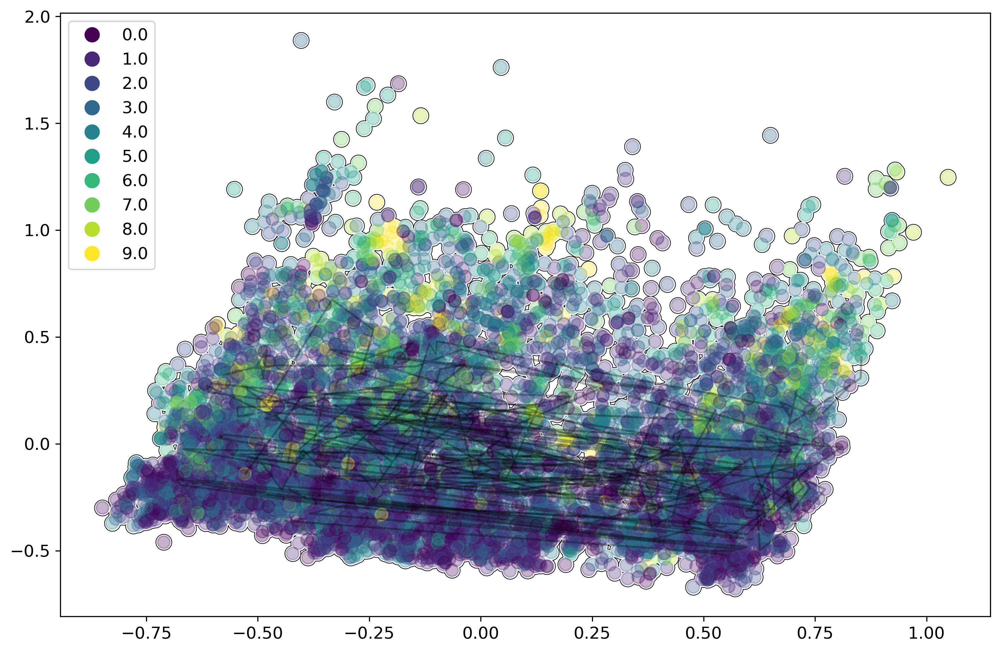

In [47]:
fig = plt.figure(figsize=(12, 8), dpi=300)
ax = fig.add_subplot(1,1,1)
scprep.plot.scatter2d(
    pca_loadings, 
    c='black', 
    figsize=(12, 8), cmap='viridis',
    s=120, alpha=1,
    ax=ax
)
scprep.plot.scatter2d(
    pca_loadings, 
    c='white', 
    figsize=(12, 8), cmap='viridis',
    s=100, alpha=1,
    ax=ax
)
scprep.plot.scatter2d(
    pca_loadings, 
#     c=DF.Time, 
    c=ptime,
    figsize=(12, 8), cmap='viridis',
    s=80, alpha=0.3,
    ax=ax
)
for idxs in list(cell_ids.values())[20:40]:
    plt.plot(pca_loadings[idxs][:, 0], pca_loadings[idxs][:, 1], alpha=0.3, color='Black');


In [48]:
df_pca = pd.DataFrame(pca_loadings, columns=[f'd{i}' for i in range(1, 11)]).join(
    pd.DataFrame(ptime, columns=['samples'])
)

In [49]:
np.unique(ptime, return_counts=True)
np.unique(df_pca.samples.values, return_counts=True)

(array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.]),
 array([1553, 2312, 1955, 1270, 1372,  608,  425,  324,  214,  142]))

In [50]:
df = df_pca

# Train autoencoder or the geodesic embedding

#### Set seeds and check GPU

In [53]:
set_seeds(0)
use_cuda = torch.cuda.is_available()

#### Handle hold-out training condition

In [54]:
# This is True if we want to holdout (or skip) one timepoint during training. It is used to test the accuracy of the trajectories on unseen data.
hold_one_out = False
# It can be a group number or 'random', works in tandem with hold_one_out
hold_out = 'random'

# The dimensions in the input space, it is columns - 1 because we assume one column is equal to "samples".
model_features = len(df.columns) - 1
groups = sorted(df.samples.unique())

In [55]:
# These determine the logic flow for training: 
#   use_emb=True use_gae=False is only the encoder to match the approximation of the geodesic.
#   use_emb=False use_gae=True the full Geodesic Autoencoder (GAE), i.e. matching the geodesic and a reconstruction loss.
#   use_emb=False use_gae=False Is not using the GAE.
#   use_emb=True use_gae=True, is redundant and should raise an error. 
use_emb = False
use_gae = True

need_to_train_gae = (use_emb or use_gae) and use_emb != use_gae

# If the reconstruction loss needs to be computed.
recon = use_gae and not use_emb 

# These are training GAE hyperparameters needed for training
# Distance_type in ['gaussian', 'alpha_decay'], and Gaussian scale
distance_type = 'gaussian'
rbf_length_scale=0.5
dist = setup_distance(distance_type, rbf_length_scale=rbf_length_scale)

#Can be changed depending on the dataset
n_epochs_emb = 1000
samples_size_emb = (30, )

# Layers for the Geodesic Autoencoder
gae_embedded_dim = 32
encoder_layers = [model_features, 8, gae_embedded_dim]

gae = Autoencoder(
    encoder_layers = encoder_layers,
    decoder_layers = encoder_layers[::-1],
    activation='ReLU', use_cuda = use_cuda
)
optimizer = torch.optim.AdamW(gae.parameters())

#### Actually train the thing

In [57]:
# Added in extra cell just for iterative programming / running of code
#   but could be added to code block above

if need_to_train_gae:
    start_time_geo = time.time()

    losses = train_ae(
        gae, df, groups, optimizer, 
        n_epochs=n_epochs_emb, sample_size=samples_size_emb,
        noise_min_scale=0.09, noise_max_scale=0.15, 
        dist=dist, recon=recon, use_cuda=use_cuda,
        hold_one_out=hold_one_out, hold_out=hold_out
    )
    run_time_geo = time.time() - start_time_geo

    print(run_time_geo)
    autoencoder = gae
else:
    autoencoder = None

  0%|          | 0/1000 [00:00<?, ?it/s]

Train loss recon: 0.16514
Train loss dist: 0.31655
Train loss recon: 0.09876
Train loss dist: 0.14915
Train loss recon: 0.08343
Train loss dist: 0.14079
Train loss recon: 0.07534
Train loss dist: 0.10757
Train loss recon: 0.06101
Train loss dist: 0.07075
Train loss recon: 0.05215
Train loss dist: 0.05953
Train loss recon: 0.05082
Train loss dist: 0.06269
Train loss recon: 0.04626
Train loss dist: 0.05973
Train loss recon: 0.04597
Train loss dist: 0.06821
Train loss recon: 0.04383
Train loss dist: 0.05988
Train loss recon: 0.03873
Train loss dist: 0.05202
Train loss recon: 0.03952
Train loss dist: 0.04142
Train loss recon: 0.03773
Train loss dist: 0.05288
Train loss recon: 0.03535
Train loss dist: 0.04462
Train loss recon: 0.03862
Train loss dist: 0.05675
Train loss recon: 0.03264
Train loss dist: 0.04768
Train loss recon: 0.03543
Train loss dist: 0.04425
Train loss recon: 0.03499
Train loss dist: 0.05517
Train loss recon: 0.03279
Train loss dist: 0.05256
Train loss recon: 0.02687
Train

# Specify parameters

In [68]:
set_seeds(10)

#Directory where results are saved
exp_name = 'mau-video'

# density loss knn
use_density_loss = True

# Weight of density (not percentage of total loss)
lambda_density = 15

# For petal=LeakyReLU / dyngen=CELU
activation = 'CELU'

# Can change but we never really do, mostly depends on the dataset.
layers = [16,32,16]

# Scale of the noise in the trajectories. Either len(groups)*[float] or None. Should be None if using an adaptative ODE solver.
sde_scales = len(groups)*[0.2] 

if recon:    
    model_features = gae_embedded_dim

model = make_model(
    model_features, layers, 
    activation=activation, scales=sde_scales, use_cuda=use_cuda
)

In [69]:
# Basically "batch size"
sample_size=(30, )

# Training specification
n_local_epochs = 200
n_epochs = 25
n_post_local_epochs = 10

criterion_name = 'ot'
criterion = config_criterion(criterion_name)

optimizer = torch.optim.AdamW(model.parameters(), lr=0.0001)

# Bookkeeping variables
batch_losses = []
globe_losses = []
if hold_one_out and hold_out in groups:
    local_losses = {f'{t0}:{t1}':[] for (t0, t1) in generate_steps(groups) if hold_out not in [t0, t1]}
else:
    local_losses = {f'{t0}:{t1}':[] for (t0, t1) in generate_steps(groups)}

# For creating output.
n_points = 20
n_trajectories = 100
n_bins = 100

reverse=True

In [70]:
opts = {
    'use_cuda': use_cuda,
    'model_features': model_features,
    'exp_name': exp_name,
    'groups': groups,
    'sample_size': sample_size,
    'use_emb': use_emb,
    'n_local_epochs': n_local_epochs,
    'n_epochs': n_epochs,
    'n_post_local_epochs': n_post_local_epochs,
    'criterion_name': criterion_name,
    'hold_one_out': hold_one_out,
    'use_density_loss': use_density_loss,
    'n_points': n_points,
    'n_trajectories': n_trajectories,
    'n_bins': n_bins,
    'autoencoder': autoencoder,
    'activation_ode': activation,
    'layer': layers,
    'lambda_density':lambda_density,
    'use_gae': use_gae,
    'sde_scales': sde_scales,
    'hold_out':hold_out,
    'encoder_layers': encoder_layers,
    'n_epochs_emb': n_epochs_emb,
    'samples_size_emb': samples_size_emb,
    'recon': recon,
    'distance_type':distance_type,
    'rbf_length_scale':rbf_length_scale,
    'reverse': reverse
}

In [71]:
exp_dir, logger = setup_exp(RES_DIR, opts, exp_name) 

In [72]:
from ToyTrajectoryNet.train import training_regimen

In [73]:
start_time = time.time()
local_losses, batch_losses, globe_losses = training_regimen(
    # local, global, local train structure
    n_local_epochs=n_local_epochs, 
    n_epochs=n_epochs, 
    n_post_local_epochs=n_post_local_epochs,
    
    # where results are stored
    exp_dir=exp_dir, 

    # BEGIN: train params
    model=model, df=df, groups=groups, optimizer=optimizer, 
    criterion=criterion, use_cuda=use_cuda,
    
    hold_one_out=hold_one_out, hold_out=hold_out,
    
    use_density_loss=use_density_loss, 
    lambda_density=lambda_density,
    
    autoencoder=autoencoder, use_emb=use_emb, use_gae=use_gae, 
    
    sample_size=sample_size, logger=logger,
    # END: train params

    plot_every=1,
    n_points=n_points, n_trajectories=n_trajectories, n_bins=n_bins, 
#     local_losses=local_losses, batch_losses=batch_losses, globe_losses=globe_losses,
    reverse_schema=reverse, reverse_n=2
)
run_time = time.time() - start_time + run_time_geo if use_emb or use_gae else time.time() - start_time
logger.info(f'Total run time: {np.round(run_time, 5)}')

Pretraining Epoch:   0%|          | 0/200 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Epoch:   0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Posttraining Epoch:   0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

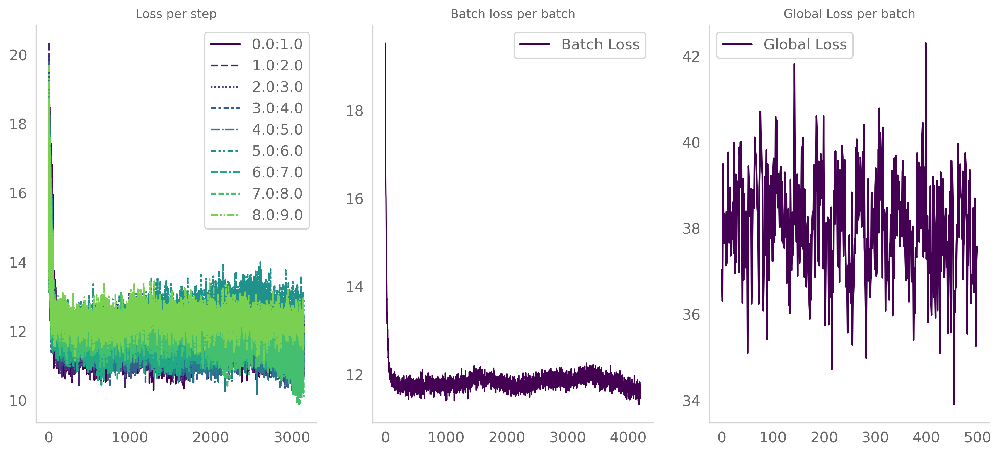

In [74]:
plot_losses(
    local_losses, batch_losses, globe_losses, 
    save=True, path=exp_dir, file='losses.png'
)

In [75]:
generated, trajectories = generate_plot_data(
    model, df, n_points, n_trajectories, n_bins, use_cuda=use_cuda, samples_key='samples', logger=logger,
    autoencoder=autoencoder, recon=recon
)

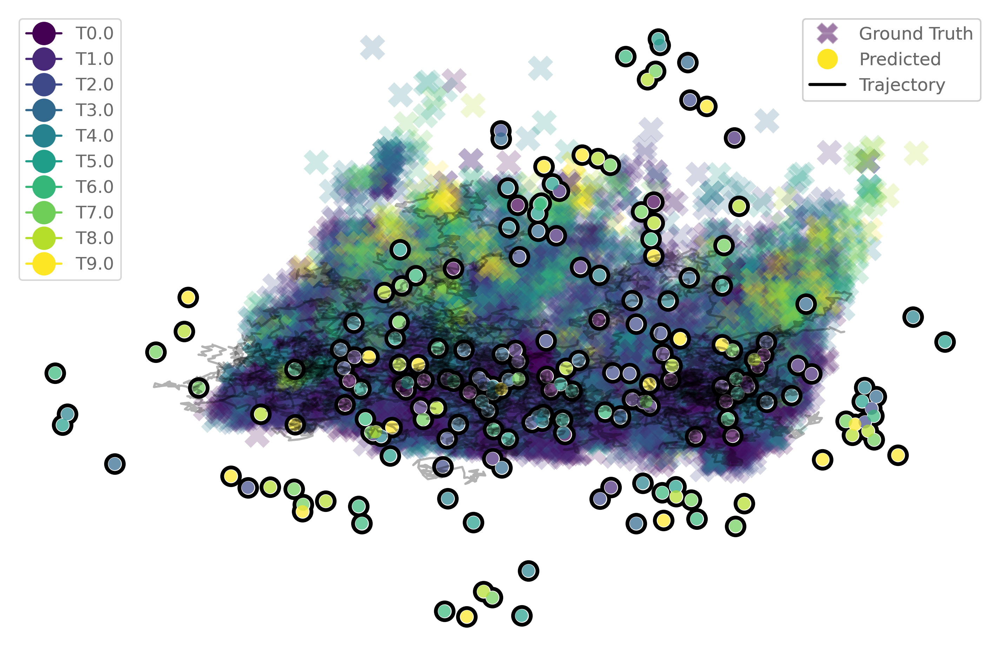

In [76]:
plot_comparision(
    df, generated, trajectories,
    palette = 'viridis', df_time_key='samples',
    save=True, path=exp_dir, file='2d_comparision.png',
    x='d1', y='d2', z='d3', is_3d=False
)

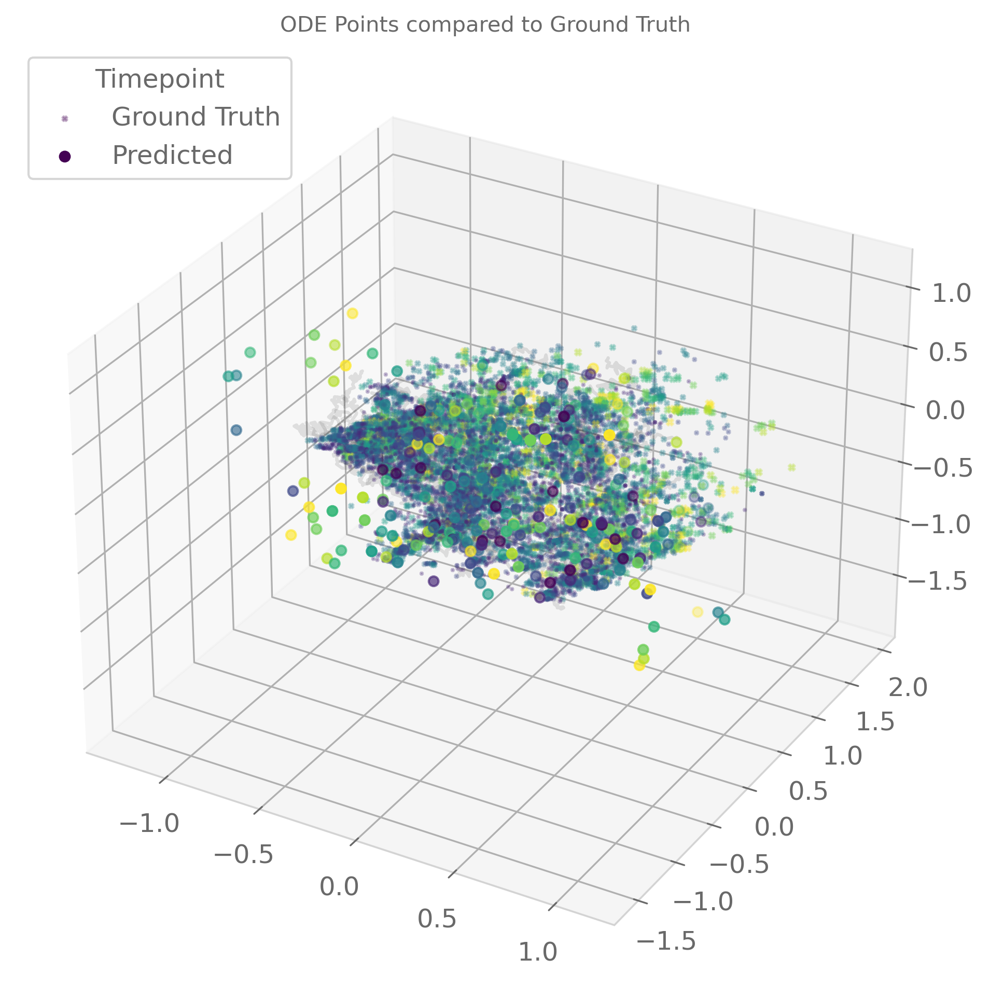

In [77]:
plot_comparision(
    df, generated, trajectories,
    palette = 'viridis', df_time_key='samples',
    save=True, path=exp_dir, file='3d_comparision.png',
    x='d1', y='d2', z='d3', is_3d=True
)

In [78]:
# saving the trajectories and generated points
#np.save(os.path.join(exp_dir,'trajectories_leave{}.npy'.format(hold_out)),trajectories)
#np.save(os.path.join(exp_dir,'generated_leave{}.npy'.format(hold_out)),generated)
torch.save(model, os.path.join(exp_dir, 'model.model'))
torch.save(autoencoder, os.path.join(exp_dir, 'autoencoder.model'))

# Trajectory Analysis

## Plotting Functions

In [394]:
from ToyTrajectoryNet.utils import to_np, get_groups_from_df, get_cell_types_from_df, get_sample_n_from_df
from ToyTrajectoryNet.eval import generate_tjnet_trajectories, get_cell_indexes
from ToyTrajectoryNet.plots import plot_gene_trends

## Trajectory Visualization

### Plot Some Trajectories

In [395]:
where = 'start'
start = 0

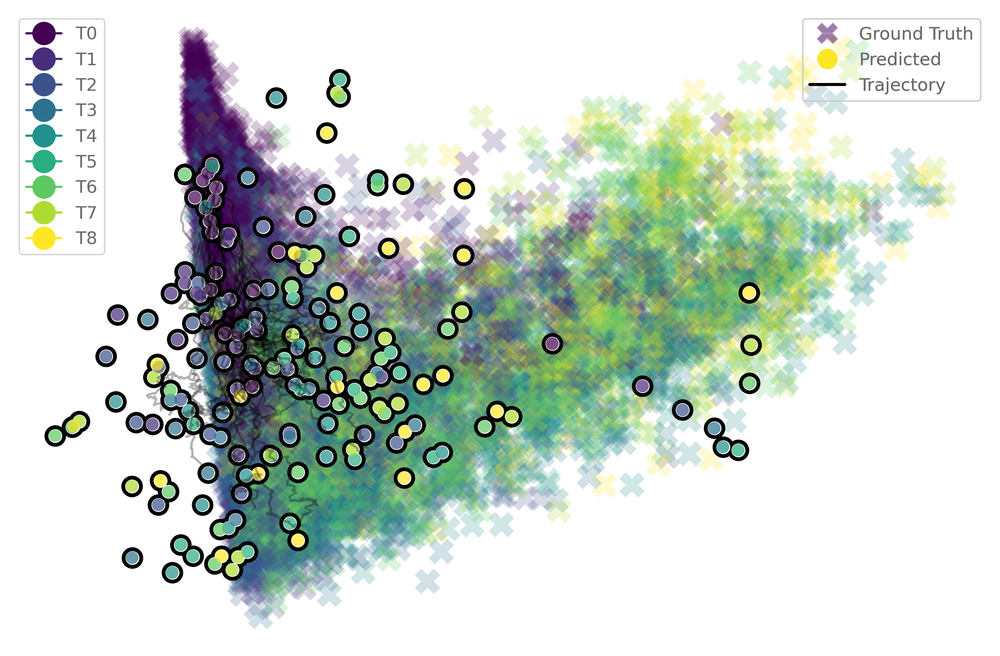

In [396]:
tjnet_trajectories = generate_tjnet_trajectories(
    model, df, use_cuda=use_cuda, autoencoder=autoencoder, recon=recon,
    where=where, start=start
)

plot_comparision(
    df, generated, 
    tjnet_trajectories[:, np.random.choice(tjnet_trajectories.shape[1], size=(30)), :],
    palette = 'viridis', df_time_key='samples',
    save=False, path=exp_dir, file='3d_comparision.png',
    x='d1', y='d2', z='d3', is_3d=False
)

### Plot GT Cell Type Labels

In [397]:
cell_types = 'AT2 AT1 Repair'.split()
cmap = sns.color_palette('viridis', n_colors=len(cell_types))
colors = dict(zip(*[
    cell_types,
    [cmap[i] for i in range(len(cell_types))]
]))
factorized = [cell_types.index(c) for c in df_at.index]
# factorized = [colors[c] for c in df_at.index]


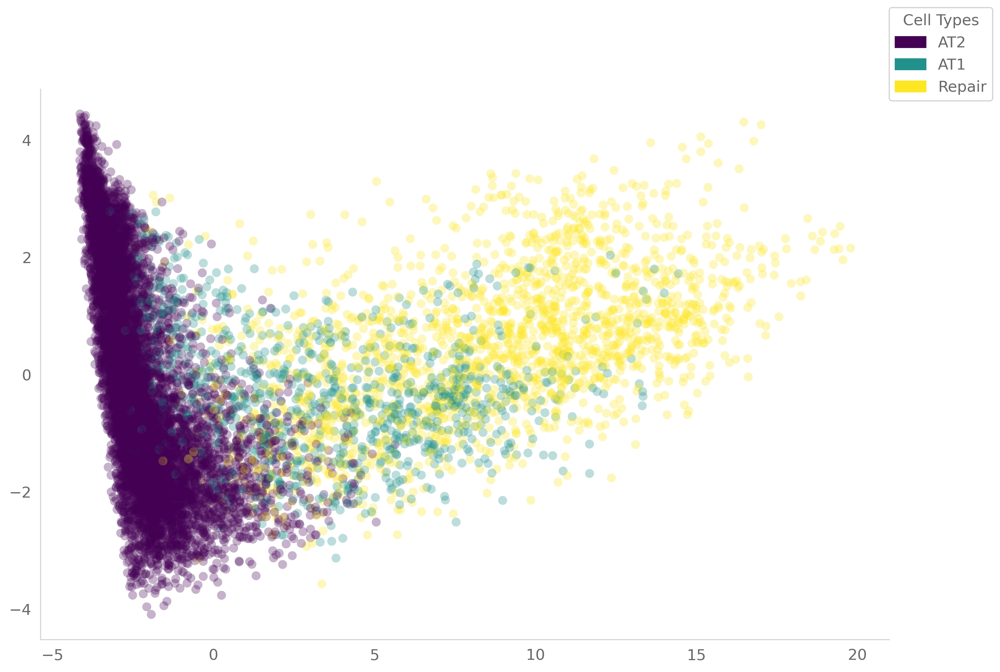

In [398]:
import matplotlib.patches as mpatches
from matplotlib import cm
fig = plt.figure(figsize=(12, 8), dpi=300)
plt.scatter(
    df['d1'], df['d2'],
#     c=pd.factorize(df_at.index)[0],
    c=factorized,
    s=50,
    alpha=0.3,
    marker='o',
    linewidths=0,
    edgecolors=None,
    cmap='viridis'
)
cmap = plt.get_cmap()
# plt.clim(0, len(cell_types))
fig.legend(
        handles=[
            mpatches.Patch(color=cmap(i/(len(cell_types)-1)), label=ctype)
            for i, ctype in enumerate(cell_types)
        ], 
        title=f'Cell Types'
    ) 

- Label Projection
- morphology markers
- AT1 subtypes (AT2 --> AT1 --> Repair vs AT2 --> Repair)

### Plot All Trajectories

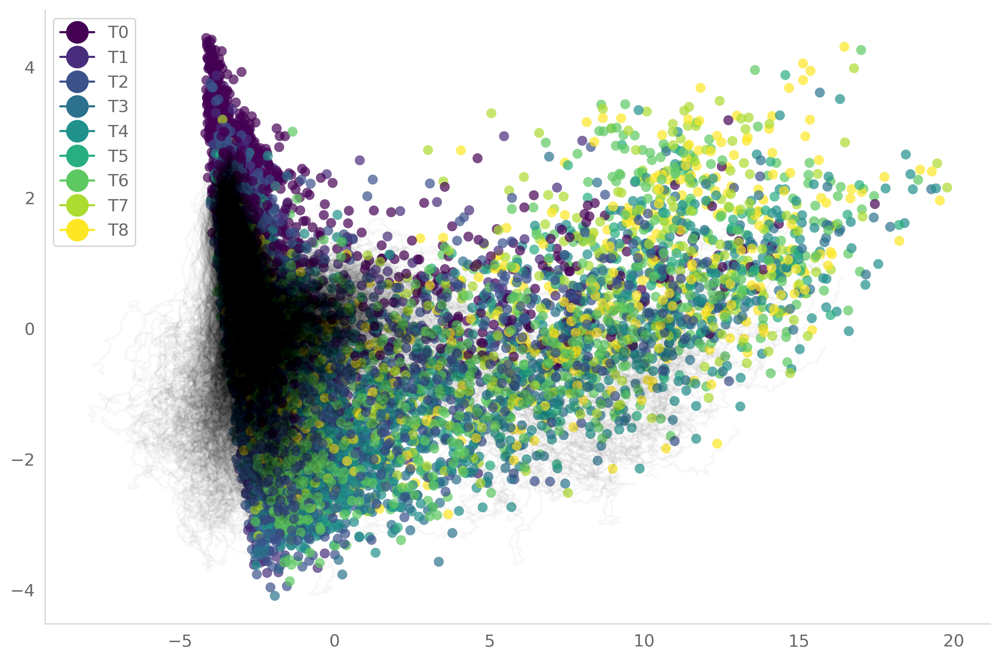

In [399]:
fig = plt.figure(figsize=(12, 8), dpi=300)
plt.scatter(
    df['d1'], df['d2'],
    c=df['samples'],
    
    s=50,
    alpha=0.7,
    marker='o',
    linewidths=0,
    edgecolors=None,
    cmap='viridis'
)
for trajectory in np.transpose(tjnet_trajectories, axes=(1,0,2)):
    plt.plot(trajectory[:, 0], trajectory[:, 1], alpha=0.03, color='Black');
    
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from matplotlib.lines import Line2D
states = sorted(df.samples.unique())
legend_elements = [        
    Line2D(
        [0], [0], marker='o', 
        color=cmap((i) / (len(states)-1)), label=f'T{state}', 
        markerfacecolor=cmap((i) / (len(states)-1)), markersize=15,
    )
    for i, state in enumerate(states)
]

leg = plt.legend(handles=legend_elements, loc='upper left')


## Run Gene Trends Analysis

In [400]:
favorite_genes = '''
Nek5 Dicer1 Fhod1 Kank2 Icam1 Reck Csf1r Sdc4
'''.split()

In [401]:
new_genes = [g for g in '''Myl12a Myl12b Rac Cdc42 Rhoa'''.split() if g in df_m.columns]

new_genes = '''
Acvr1 Prkca Mmp14 Sema3c Mylk Itga3 Myh9 Fam171a1
Cnn3 Cnn2 Csrp1 Csrp2 Nebl Fhod1 Arpc5l
'''.split()

In [402]:
genes = favorite_genes
where = 'start'
start = 0

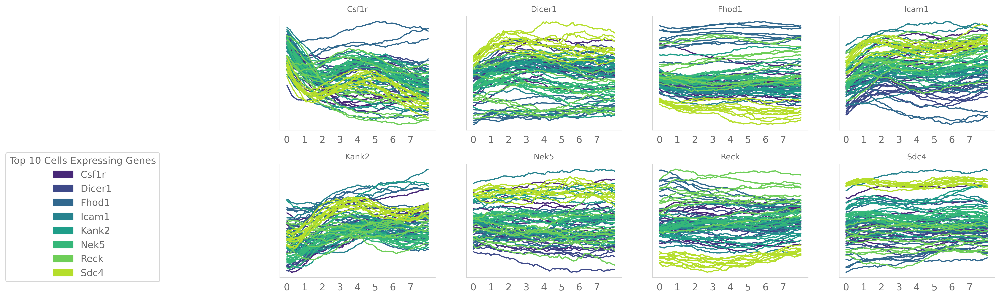

In [403]:
use_cell_types=False
tjnet_trajectories = generate_tjnet_trajectories(
    model, df, use_cuda=use_cuda, autoencoder=autoencoder, recon=recon,
    where=where, start=start, 
)

# pcs = phate_operator.graph.data_pca.components_
pcs = pca_components
genes, top_idxs, inverse, colors = get_cell_indexes(
    df_m, genes, tjnet_trajectories, pca_components, 
    where=where, start=start, samples=df.samples, use_cell_types=use_cell_types,
#     palette='tab10',
)
fig = plot_gene_trends(
    genes, top_idxs, inverse, colors, n_cols=4, samples=df.samples, where=where, start=start, 
    cell_types='AT1 AT2 Repair'.split(), use_cell_types=use_cell_types
)
fig

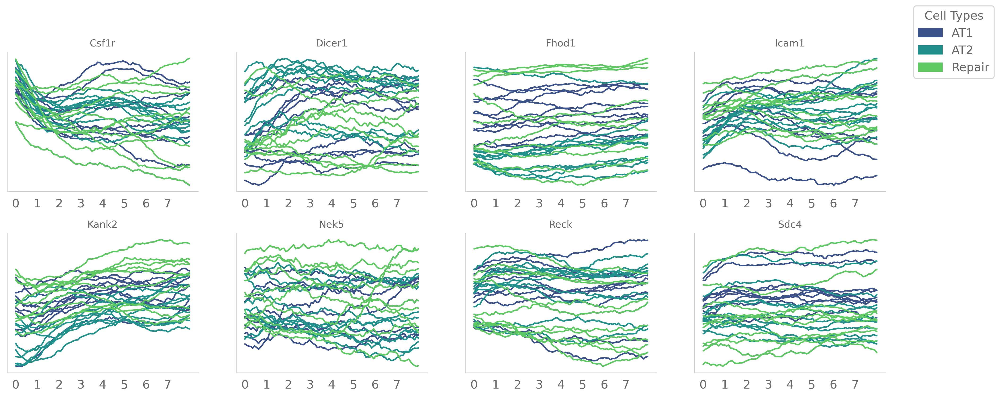

In [404]:
use_cell_types = True

tjnet_trajectories = generate_tjnet_trajectories(
    model, df, use_cuda=use_cuda, autoencoder=autoencoder, recon=recon,
    where=where, start=start, 
)
genes, top_idxs, inverse, colors = get_cell_indexes(
    df_m, genes, tjnet_trajectories, pca_components, 
    where=where, start=start, samples=df.samples, use_cell_types=use_cell_types,
#     palette='tab10'
)
fig = plot_gene_trends(
    genes, top_idxs, inverse, colors, n_cols=4, samples=df.samples, where=where, start=start, 
    cell_types='AT1 AT2 Repair'.split(), use_cell_types=use_cell_types
)
fig

## Label Projection

In [405]:
n_bins = 10
start = 0
k = 10
starting_cells_trajectories = generate_tjnet_trajectories(
    model, df, use_cuda=use_cuda, autoencoder=autoencoder, recon=recon,
    where='start', start=start, n_bins=n_bins
)

In [406]:
starting_cells_gene_space = np.dot(starting_cells_trajectories, pca_components)

In [407]:
from sklearn.neighbors import NearestNeighbors

In [408]:
results = []
for i, t in enumerate(sorted(df.samples.unique())[start:]):
    X = df_at.reset_index()[df.samples == t]
    nbrs = NearestNeighbors(n_neighbors=k, algorithm='ball_tree', n_jobs=-1)\
        .fit(X.drop(columns='cell.type.ident'.split()))
    
    for _bin in range(n_bins):
        trajectory_idx = i * n_bins + _bin
        dists, indxs = nbrs.kneighbors(
            pd.DataFrame(starting_cells_gene_space[trajectory_idx], columns=df_at.columns)
        )

        
        projected_cell_types = []
        for closest_cells_to_cell in indxs:
            types, counts = np.unique(X['cell.type.ident'].iloc[closest_cells_to_cell], return_counts=True)
            highest_vote_loc = np.where(counts == np.max(counts))[0][0]
            highest_vote_type = types[highest_vote_loc]
            projected_cell_types.append(highest_vote_type)
            
        results.append(projected_cell_types)
results = np.array(results)        

In [409]:
tmp = []
for t in range(results.shape[0]):
    for c in range(results.shape[1]):
        
        tmp.append({'cell_id': c, 'time': start + (t / n_bins), 'type': results[t, c]})

In [410]:
pd.DataFrame(tmp).type.unique()

array(['AT2', 'AT1'], dtype=object)

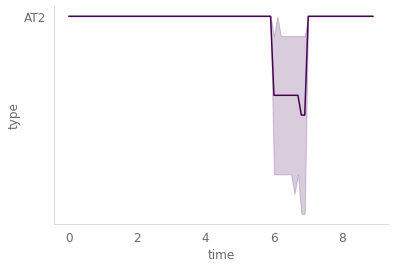

In [411]:
g = sns.lineplot(
    data=pd.DataFrame(tmp), 
    x='time', y='type', legend='full'
)

In [412]:
y = g.get_yaxis()

In [413]:
y.get_ticklabels()

[Text(0, 0, 'AT2'), Text(0, 1, 'AT1')]